# Projet Convertion Rate

Le but de ce projet est d'arriver à prédire si un utilisateur va acheter ou non sur le site

In [126]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler,OneHotEncoder,PolynomialFeatures
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression,SGDClassifier
from sklearn.svm import LinearSVC, SVC
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier, VotingClassifier,StackingClassifier
from sklearn.pipeline import Pipeline
from sklearn.metrics import f1_score, confusion_matrix,ConfusionMatrixDisplay,recall_score,precision_score

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

# EDA

In [ ]:
Les valeurs manquantes : vérifiez s'il y a des données manquantes dans votre ensemble de données et déterminez la meilleure façon de les traiter.
La distribution des données : examinez la distribution de vos données pour voir si elle suit une distribution normale ou non.
Les valeurs aberrantes : recherchez les valeurs aberrantes ou les valeurs extrêmes qui peuvent affecter les performances de votre modèle.
Les corrélations : déterminez les corrélations entre les différentes variables de votre ensemble de données pour voir si elles sont positives, négatives ou nulles.
Les relations entre les variables : explorez les relations entre les différentes variables de votre ensemble de données pour voir si elles ont une relation linéaire ou non-linéaire.
Les distributions par classe : examinez la distribution des valeurs de la variable cible (dans votre cas, le fait qu'un utilisateur effectue un achat ou non) pour voir s'il y a des biais de classe.

### Lecture du fichier data

In [3]:
data = pd.read_csv('conversion_data_train.csv')

### Analyse

In [4]:
# Basic stats
print("Number of rows : {}".format(data.shape[0]))
print()

print("Display of dataset: ")
display(data.head())
print()

print("Basics statistics: ")
data_desc = data.describe(include='all')
display(data_desc)
print()

print("Percentage of missing values: ")
display(100*data.isnull().sum()/data.shape[0])

Number of rows : 284580

Display of dataset: 


,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0



Basics statistics: 


,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000



Percentage of missing values: 


country                0.0
age                    0.0
new_user               0.0
source                 0.0
total_pages_visited    0.0
converted              0.0
dtype: float64

Analyse des statistiques basiques: 
Country : 4 valeurs différentes dont 1 représente plus de 50% des resultats
Age : Un age est à 123 ans... ce qui est impossible => A corriger
new_user = 68% de nouveau utilisateurs
source : 3 sources dont une représente presque 50%
Nombre de pages visité La moyenne est de 4 pages visité... nous avons des visiteurs à 29 pages... outlier à corriger? 
Converted : le taux de conversion est très faible... 3% sur 284580 visites , 8500 clients...
Pas de valeurs manquantes

In [5]:
#l'age minimum est à 17 ans, ce qui parrait cohérent pour réaliser des achats sur internet. pas de nettoyage de la borne basse
#Voyons la borne haute en traçantle graphique des conversions par ages 
px.histogram(data[data['age']> 50],x='age',color = 'converted', facet_row = 'converted')
#On voit clairement que le nombre d'achat est extremement faible au dessus de 50 ans, qu'il y a quelque outliers nous pouvons nous séparer de toutes les lignes > 80 ans

In [6]:
#On coupe à 80
mask = data['age'] > 80
data = data[~mask]

In [7]:
#Graphe des probas d'achat en fonction de l'age
num_features = ['age']
for f in num_features:
    fig = px.histogram(data, f, color = 'converted', facet_row = 'converted', histnorm = 'probability')
    fig.show()

En affichant sous forme de probabilité on constat sur le produit fonctionne pour les jeunes adultes 17 - 25 ans 

In [8]:
#Calculons le ratio d'achat par total_pages_visited  NB achat / Nb visiteurs
data_tpv = data.groupby('total_pages_visited').sum(numeric_only=True) / data.groupby('total_pages_visited').count()
px.bar(data_tpv,x=data_tpv.index,y='converted')

On constate que le nombre de pages visitées sur le site indique une bonne probabilité d'achat ... cette courbe ressemble à une sigmoid

In [192]:
# Visualize pairwise dependencies
fig = px.scatter_matrix(data, color='converted', dimensions=['age','country','new_user','source','total_pages_visited'])
fig.update_layout(
        title = go.layout.Title(text = "Bivariate analysis", x = 0.5), showlegend = False, 
            autosize=False, height=1000, width = 1000)
fig.update_traces(diagonal_visible=False)
fig.show()

In [195]:
data_clean = data.drop_duplicates()

In [197]:
data.shape

(284578, 6)

In [196]:
data_clean.shape

(15809, 6)

# MODEL CLASSIFICATION LINERAIRE (Template)

Explanatory variables :  Index(['total_pages_visited'], dtype='object')

Dividing into train and test sets...
...Done.

Convert pandas DataFrames to numpy arrays...
...Done
[[6]
 [5]
 [2]
 [6]
 [4]]
[[7]
 [2]]

[0 0 0 0 0]
[0 0]
Encoding categorical features and standardizing numerical features...
...Done
[[ 0.33742062]
 [ 0.03809786]
 [-0.85987044]
 [ 0.33742062]
 [-0.26122491]]
Train model...
...Done.
Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Encoding categorical features and standardizing numerical features...
...Done
[[ 0.63674339]
 [-0.85987044]
 [-1.15919321]
 [-0.85987044]
 [ 0.93606615]]
Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]

f1-score on train set :  0.6957985550957425
f1-score on test set :  0.6893203883495146


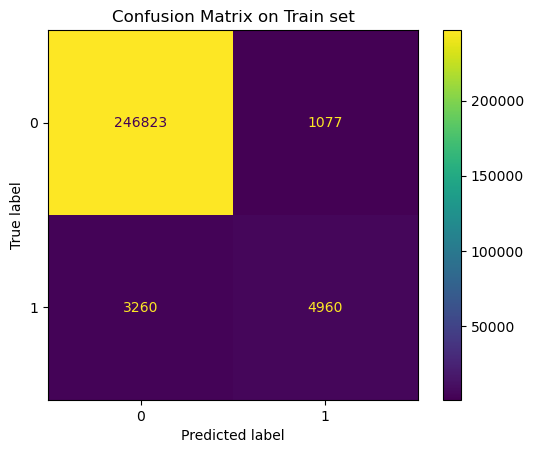

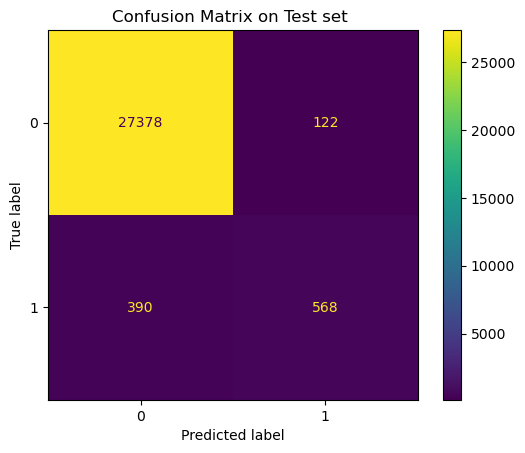

In [9]:
#Définition de la feature à analyser
features_list = ['total_pages_visited']
numeric_indices = [0]
categorical_indices = []

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=0)
print("...Done.")
print()

# Convert pandas DataFrames to numpy arrays before using scikit-learn
print("Convert pandas DataFrames to numpy arrays...")
X_train = X_train.values
X_test = X_test.values
Y_train = Y_train.values
Y_test = Y_test.values
print("...Done")

print(X_train[0:5,:])
print(X_test[0:2,:])
print()
print(Y_train[0:5])
print(Y_test[0:2])

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
featureencoder = StandardScaler()
X_train = featureencoder.fit_transform(X_train)
print("...Done")
print(X_train[0:5,:])

# Train model
print("Train model...")
classifier = LogisticRegression() # 
classifier.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(classifier, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(classifier, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

Nous avons un score de 0,7 Essayons de faire mieux. 
On voit que le modèle arrive bien à prédire le non achat, mais il se trompe autant qu'il réussi à prédire les achats. Essayons d'ameliorer


# Model Classification lineaire avec split 0.2 et stratify

Nous allons juste changer deux parametres sur la découpe du Xtrain Ytrain

Explanatory variables :  Index(['total_pages_visited'], dtype='object')

Dividing into train and test sets...
...Done.

Convert pandas DataFrames to numpy arrays...
...Done
[[5]
 [4]
 [2]
 [8]
 [2]]
[[1]
 [5]]

[0 0 0 0 0]
[0 0]
Encoding categorical features and standardizing numerical features...
...Done
[[ 0.0376251 ]
 [-0.2616379 ]
 [-0.86016391]
 [ 0.9354141 ]
 [-0.86016391]]
Train model...
...Done.
Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Encoding categorical features and standardizing numerical features...
...Done
[[-1.15942691]
 [ 0.0376251 ]
 [-1.15942691]
 [-1.15942691]
 [-0.56090091]]
Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]

f1-score on train set :  0.6959943338317462
f1-score on test set :  0.691682301438399


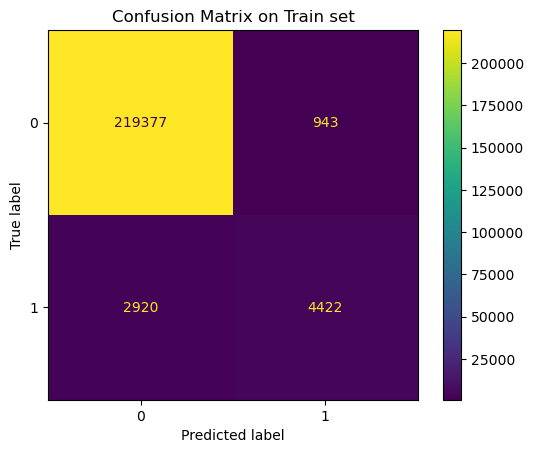

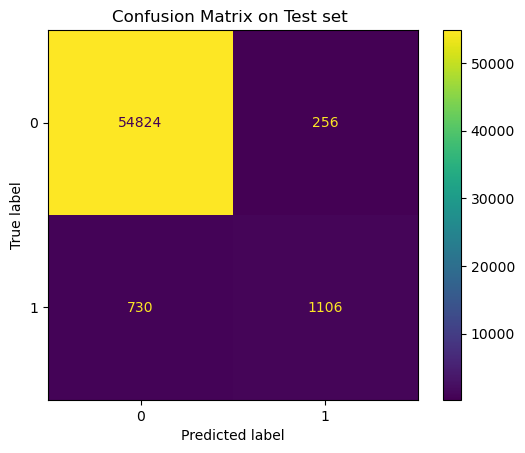

In [93]:
#Définition de la feature à analyser
features_list = ['total_pages_visited']
numeric_indices = [0]
categorical_indices = []

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
print("...Done.")
print()

# Convert pandas DataFrames to numpy arrays before using scikit-learn
print("Convert pandas DataFrames to numpy arrays...")
X_train = X_train.values
X_test = X_test.values
Y_train = Y_train.values
Y_test = Y_test.values
print("...Done")

print(X_train[0:5,:])
print(X_test[0:2,:])
print()
print(Y_train[0:5])
print(Y_test[0:2])

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
featureencoder = StandardScaler()
X_train = featureencoder.fit_transform(X_train)
print("...Done")
print(X_train[0:5,:])

# Train model
print("Train model...")
tot_pg_only_classifier = LogisticRegression() # 
tot_pg_only_classifier.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = tot_pg_only_classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = tot_pg_only_classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(tot_pg_only_classifier, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(tot_pg_only_classifier, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

# Model Classification lineaire ajout de la feature age

Explanatory variables :  Index(['total_pages_visited', 'age'], dtype='object')

Dividing into train and test sets...
...Done.

Convert pandas DataFrames to numpy arrays...
...Done
[[ 5 23]
 [ 4 26]
 [ 2 39]
 [ 8 39]
 [ 2 44]]
[[ 1 34]
 [ 5 32]]

[0 0 0 0 0]
[0 0]
Encoding categorical features and standardizing numerical features...
...Done
[[ 0.0376251  -0.91614386]
 [-0.2616379  -0.55333446]
 [-0.86016391  1.01883962]
 [ 0.9354141   1.01883962]
 [-0.86016391  1.62352196]]
Train model...
...Done.
Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Encoding categorical features and standardizing numerical features...
...Done
[[-1.15942691  0.41415728]
 [ 0.0376251   0.17228435]
 [-1.15942691  1.62352196]
 [-1.15942691  0.53509375]
 [-0.56090091 -0.19052506]]
Predictions on test set...
...Done.
[0 0 0 ... 0 0 0]

f1-score on train set :  0.7094216417910448
f1-score on test set :  0.7057728119180633


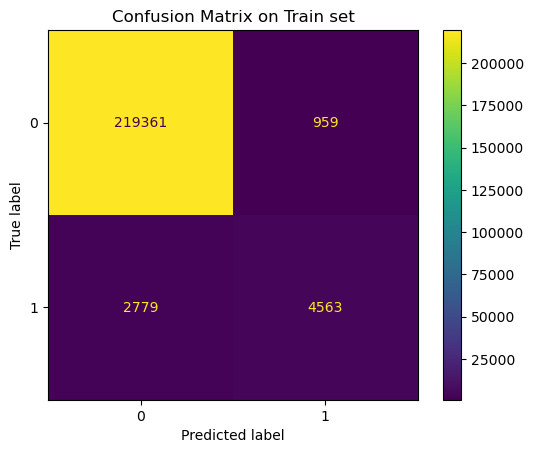

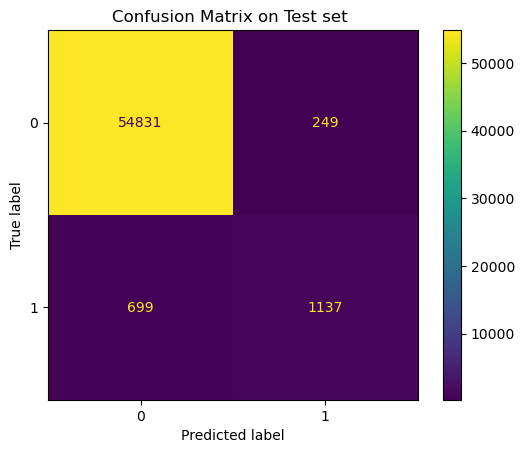

In [12]:
#Définition de la feature à analyser
features_list = ['total_pages_visited','age']
numeric_indices = [0]
categorical_indices = []

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
print("...Done.")
print()

# Convert pandas DataFrames to numpy arrays before using scikit-learn
print("Convert pandas DataFrames to numpy arrays...")
X_train = X_train.values
X_test = X_test.values
Y_train = Y_train.values
Y_test = Y_test.values
print("...Done")

print(X_train[0:5,:])
print(X_test[0:2,:])
print()
print(Y_train[0:5])
print(Y_test[0:2])

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
featureencoder = StandardScaler()
X_train = featureencoder.fit_transform(X_train)
print("...Done")
print(X_train[0:5,:])

# Train model
print("Train model...")
classifier = LogisticRegression() # 
classifier.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(classifier, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(classifier, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

Le f1score augmente sensiblement... mais ce n'est pas encore très exploitable

# Model Classification lineaire avec toutes les features

Explanatory variables :  Index(['total_pages_visited', 'age', 'new_user', 'country', 'source'], dtype='object')

Dividing into train and test sets...
...Done.

Encoding categorical features and standardizing numerical features...
Performing preprocessings on train set...
        total_pages_visited  age  new_user  country  source
70238                     5   23         0       US  Direct
11738                     4   26         1       US     Ads
51223                     2   39         1  Germany     Ads
251695                    8   39         1       US     Seo
30005                     2   44         1       US     Seo
...Done.
[[ 0.0376251  -0.91614386 -1.47777425  0.          0.          1.
   1.          0.        ]
 [-0.2616379  -0.55333446  0.67669334  0.          0.          1.
   0.          0.        ]
 [-0.86016391  1.01883962  0.67669334  1.          0.          0.
   0.          0.        ]
 [ 0.9354141   1.01883962  0.67669334  0.          0.          1.
   0.         

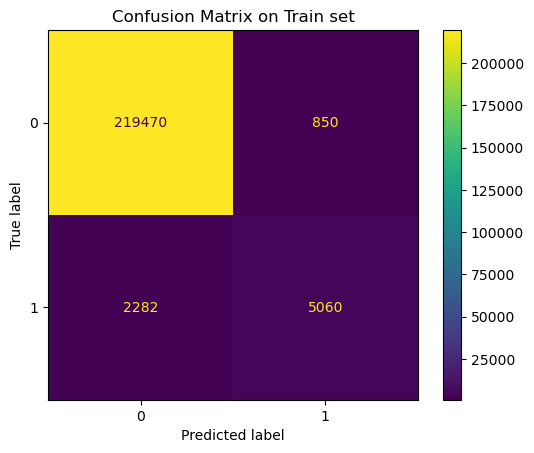

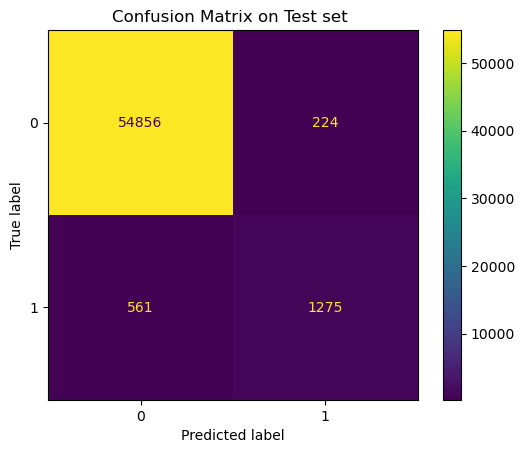

In [24]:
#Définition de la feature à analyser
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#features_list = ['total_pages_visited','age','new_user']
#numeric_indices = [0]
#categorical_indices = ['country','source']

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
print("...Done.")
print()

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
numeric_transformer = Pipeline(steps=[
        ('scaler', StandardScaler())
    ])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

print("Performing preprocessings on train set...")
print(X_train.head())
X_train = featureencoder.fit_transform(X_train)
print('...Done.')
print(X_train[0:5]) # MUST use this syntax because X_train is a numpy array and not a pandas DataFrame anymore
print()

# Train model
print("Train model...")
classifier = LogisticRegression() # 
classifier.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(classifier, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(classifier, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

Le modèle s'améliore beaucoup le F1 score est à 0.7646 et la matrice de confusion nous montre que les erreurs ne représentent plus la totalité des cas "converted" justement classé 

# Model classification lineaire, avec feature augmentation (FA)

Essayons une technique classique de feature augmentation : passons les features numériques à des degrès supérieurs

Explanatory variables :  Index(['total_pages_visited', 'age', 'new_user', 'country', 'source'], dtype='object')

Dividing into train and test sets...
...Done.

Encoding categorical features and standardizing numerical features...
Performing preprocessings on train set...
        total_pages_visited  age  new_user  country  source
70238                     5   23         0       US  Direct
11738                     4   26         1       US     Ads
51223                     2   39         1  Germany     Ads
251695                    8   39         1       US     Seo
30005                     2   44         1       US     Seo
...Done.
[[ 0.          0.0376251  -0.91614386 -1.47777425 -0.18892041 -0.3040312
  -0.96360965 -0.86600142 -1.33113427 -1.47777425 -0.23062196 -0.30230699
  -0.55566961 -0.49849119 -0.91396126 -0.96360965 -0.77914159 -1.0594016
  -1.33113427 -1.47777425 -0.1937445  -0.26905442 -0.32093194 -0.3751293
  -0.55272491 -0.55566961 -0.54713198 -0.78297886 -0.91396126 -0.9

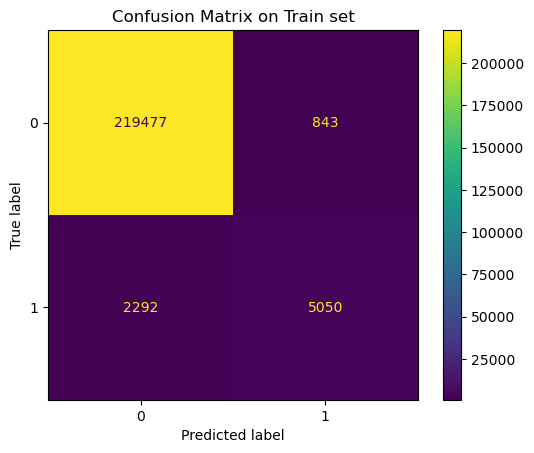

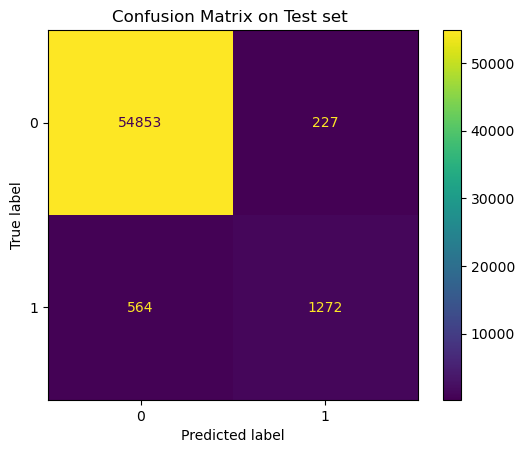

In [23]:
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
print("...Done.")
print()

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
numeric_transformer = Pipeline(steps=[
        ('poly',PolynomialFeatures(4)),
        ('scaler', StandardScaler())
        #('spline', SplineTransformer(degree=3,n_knots=10))
])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

print("Performing preprocessings on train set...")
print(X_train.head())
X_train = featureencoder.fit_transform(X_train)
print('...Done.')
print(X_train[0:5]) # MUST use this syntax because X_train is a numpy array and not a pandas DataFrame anymore
print()

# Train model
print("Train model...")
classifier = LogisticRegression(max_iter=1000) # 
classifier.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(classifier, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(classifier, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

Le f1_score est maintenant à 0.7628 un peu moins bon que le précédent sans les polynomes.

# Model SGD

Explanatory variables :  Index(['total_pages_visited', 'age', 'new_user', 'country', 'source'], dtype='object')

Dividing into train and test sets...
...Done.

Encoding categorical features and standardizing numerical features...
Performing preprocessings on train set...
        total_pages_visited  age  new_user  country  source
70238                     5   23         0       US  Direct
11738                     4   26         1       US     Ads
51223                     2   39         1  Germany     Ads
251695                    8   39         1       US     Seo
30005                     2   44         1       US     Seo
...Done.
[[ 0.0376251  -0.91614386 -1.47777425  0.          0.          1.
   1.          0.        ]
 [-0.2616379  -0.55333446  0.67669334  0.          0.          1.
   0.          0.        ]
 [-0.86016391  1.01883962  0.67669334  1.          0.          0.
   0.          0.        ]
 [ 0.9354141   1.01883962  0.67669334  0.          0.          1.
   0.         

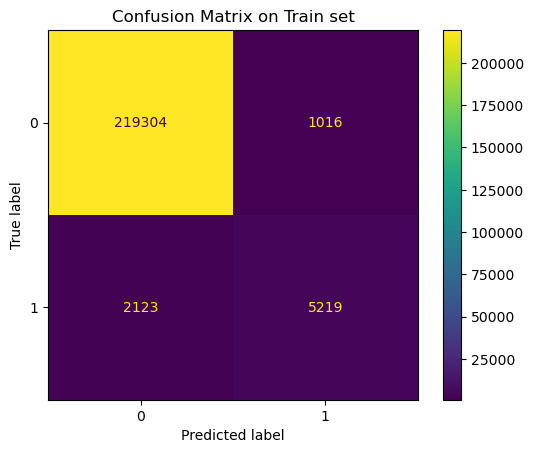

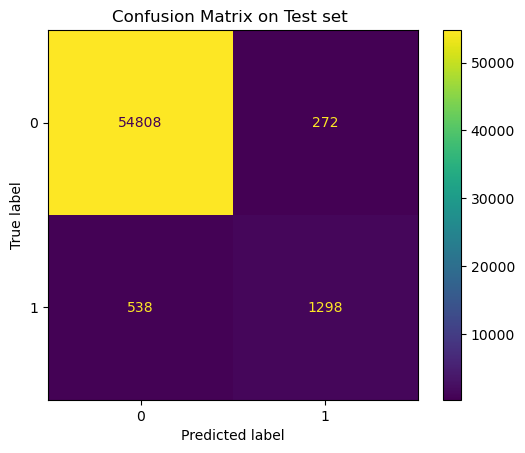

In [79]:
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
print("...Done.")
print()

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
numeric_transformer = Pipeline(steps=[
        ('scaler', StandardScaler())
])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

print("Performing preprocessings on train set...")
print(X_train.head())
X_train = featureencoder.fit_transform(X_train)
print('...Done.')
print(X_train[0:5]) # MUST use this syntax because X_train is a numpy array and not a pandas DataFrame anymore
print()

# Train model
print("Train model...")
SGD_classifier = SGDClassifier(max_iter=1000,loss='log_loss') # 
SGD_classifier.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = SGD_classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = SGD_classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(SGD_classifier, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(SGD_classifier, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

Le SGD par défaut nous donnes de tres bon résultat, on passe a F1_score de 0,7647. Essayon un GRID Search pour améliorer le modèle

In [28]:
print("Grid search...")
params = {
    'alpha' : [0.0001,0.001,0.01],
    'loss':['hinge','perceptron'],
    'eta0' : [0,1],
    'learning_rate' :['optimal','constant'],
    'penalty' : ['l2',None]
}
gridsearch = GridSearchCV(SGD_classifier, param_grid = params, cv = 10) # cv : the number of folds to be used for CV
gridsearch.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)

Grid search...
...Done.
Best hyperparameters :  {'alpha': 0.0001, 'eta0': 0, 'learning_rate': 'optimal', 'loss': 'hinge', 'penalty': None}
Best validation accuracy :  0.9861593082265756


/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning:


120 fits failed out of a total of 480.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
120 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/linear_model/_stochastic_gradient.py", line 892, in fit
    self._more_validate_params()
  File "/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn

Le GRIDSEARCH nous donne les paramètres par défaut. Donc on les conserve

# Model Linear SVC

Explanatory variables :  Index(['total_pages_visited', 'age', 'new_user', 'country', 'source'], dtype='object')

Dividing into train and test sets...
...Done.

Encoding categorical features and standardizing numerical features...
Performing preprocessings on train set...
        total_pages_visited  age  new_user  country  source
70238                     5   23         0       US  Direct
11738                     4   26         1       US     Ads
51223                     2   39         1  Germany     Ads
251695                    8   39         1       US     Seo
30005                     2   44         1       US     Seo
...Done.
[[ 0.0376251  -0.91614386 -1.47777425  0.          0.          1.
   1.          0.        ]
 [-0.2616379  -0.55333446  0.67669334  0.          0.          1.
   0.          0.        ]
 [-0.86016391  1.01883962  0.67669334  1.          0.          0.
   0.          0.        ]
 [ 0.9354141   1.01883962  0.67669334  0.          0.          1.
   0.         

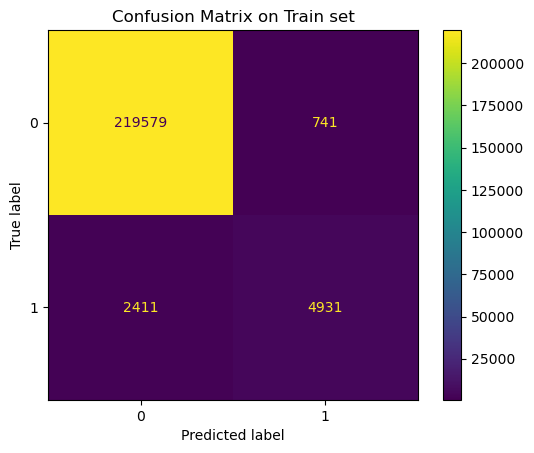

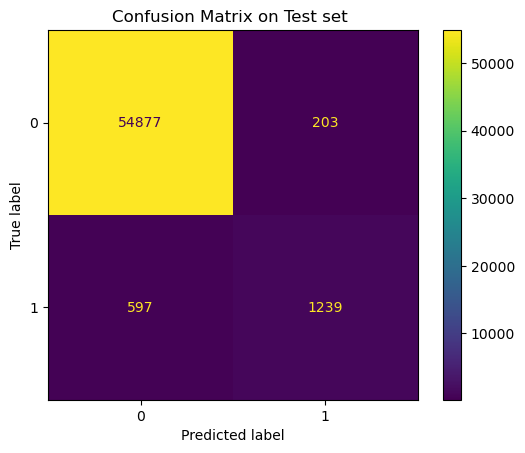

In [85]:
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
print("...Done.")
print()

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
numeric_transformer = Pipeline(steps=[
        ('scaler', StandardScaler())
])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

print("Performing preprocessings on train set...")
print(X_train.head())
X_train = featureencoder.fit_transform(X_train)
print('...Done.')
print(X_train[0:5]) # MUST use this syntax because X_train is a numpy array and not a pandas DataFrame anymore
print()

# Train model
print("Train model...")
#LSVC_classifier = LinearSVC(max_iter=1000) # 
#LSVC_classifier = LinearSVC(max_iter=10000,penalty='l2',loss='hinge',C=1) 
#Loss HINGE incompatible avec voting car les probas ne sont pas calculables
LSVC_classifier = LinearSVC(max_iter=10000,penalty='l2',C=1) 

LSVC_classifier.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = LSVC_classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = LSVC_classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(LSVC_classifier, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(LSVC_classifier, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

Moins bon que SGD sur le f1 0,755. Essayons gridsearch => Après essai 0.7575 ce qui est un peu mieux. Conservons ces valeurs

In [52]:
print("Grid search...")
params = {
    'C' : [0.001,0.01,0.1,1],
    'loss':['hinge','squared_hinge'],
    'penalty' : ['l2','l1'],
    'max_iter' : [10000]
}
gridsearch = GridSearchCV(LSVC_classifier, param_grid = params, cv = 10) # cv : the number of folds to be used for CV
gridsearch.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)

Grid search...
...Done.
Best hyperparameters :  {'C': 0.1, 'loss': 'squared_hinge', 'max_iter': 10000, 'penalty': 'l2'}
Best validation accuracy :  0.9861329525568504


/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning:


80 fits failed out of a total of 160.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
40 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/svm/_classes.py", line 274, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/skle

# Model SVC

Explanatory variables :  Index(['total_pages_visited', 'age', 'new_user', 'country', 'source'], dtype='object')

Dividing into train and test sets...
...Done.

Encoding categorical features and standardizing numerical features...
Performing preprocessings on train set...
        total_pages_visited  age  new_user  country  source
70238                     5   23         0       US  Direct
11738                     4   26         1       US     Ads
51223                     2   39         1  Germany     Ads
251695                    8   39         1       US     Seo
30005                     2   44         1       US     Seo
...Done.
[[ 0.0376251  -0.91614386 -1.47777425  0.          0.          1.
   1.          0.        ]
 [-0.2616379  -0.55333446  0.67669334  0.          0.          1.
   0.          0.        ]
 [-0.86016391  1.01883962  0.67669334  1.          0.          0.
   0.          0.        ]
 [ 0.9354141   1.01883962  0.67669334  0.          0.          1.
   0.         

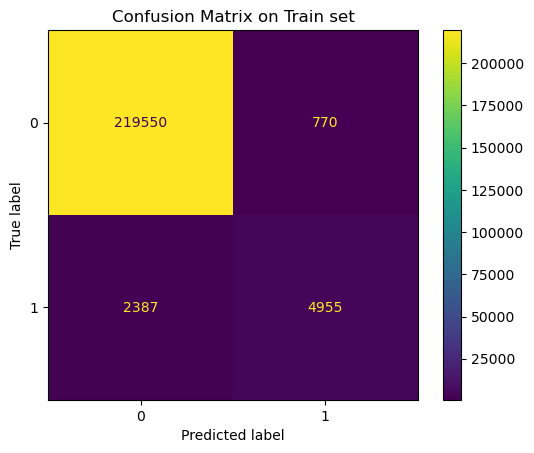

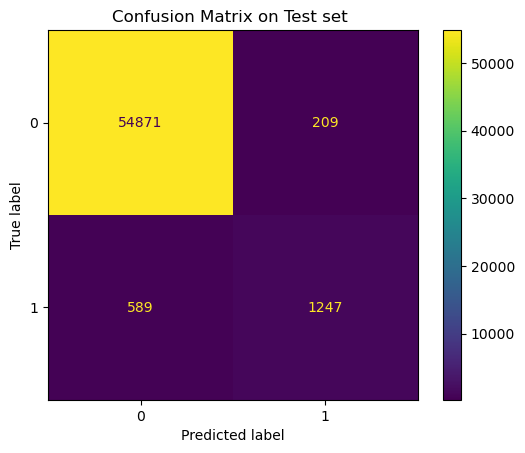

In [82]:
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
print("...Done.")
print()

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
numeric_transformer = Pipeline(steps=[
        ('scaler', StandardScaler())
])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

print("Performing preprocessings on train set...")
print(X_train.head())
X_train = featureencoder.fit_transform(X_train)
print('...Done.')
print(X_train[0:5]) # MUST use this syntax because X_train is a numpy array and not a pandas DataFrame anymore
print()

# Train model
print("Train model...")
#SVC_classifier = SVC() 
SVC_classifier = SVC(C = 1, degree=2,kernel='linear',probability=True) 

SVC_classifier.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = SVC_classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = SVC_classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(SVC_classifier, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(SVC_classifier, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

0.749 essayons grid search qui nous donne 0,75759

In [60]:
print("Grid search...")
params = {
    'C' : [0.001,0.01,0.1,1],
    'kernel' : ['linear', 'poly', 'rbf', 'sigmoid'],
    'degree' : [2,3,4],
    'max_iter' : [10000]
}
gridsearch = GridSearchCV(SVC_classifier, param_grid = params, cv = 10) # cv : the number of folds to be used for CV
gridsearch.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)

Grid search...


/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/svm/_base.py:299: ConvergenceWarning:

Solver terminated early (max_iter=10000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.

/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/svm/_base.py:299: ConvergenceWarning:

Solver terminated early (max_iter=10000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.

/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/svm/_base.py:299: ConvergenceWarning:

Solver terminated early (max_iter=10000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.

/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/svm/_base.py:299: ConvergenceWarning:

Solver terminated early (max_iter=10000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.

/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/svm/

...Done.
Best hyperparameters :  {'C': 1, 'degree': 2, 'kernel': 'linear', 'max_iter': 10000}
Best validation accuracy :  0.9861900560255883


/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/svm/_base.py:299: ConvergenceWarning:

Solver terminated early (max_iter=10000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.



# Model Random Forest

Explanatory variables :  Index(['total_pages_visited', 'age', 'new_user', 'country', 'source'], dtype='object')

Dividing into train and test sets...
...Done.

Encoding categorical features and standardizing numerical features...
Performing preprocessings on train set...
        total_pages_visited  age  new_user  country  source
70238                     5   23         0       US  Direct
11738                     4   26         1       US     Ads
51223                     2   39         1  Germany     Ads
251695                    8   39         1       US     Seo
30005                     2   44         1       US     Seo
...Done.
[[ 5. 23.  0.  0.  0.  1.  1.  0.]
 [ 4. 26.  1.  0.  0.  1.  0.  0.]
 [ 2. 39.  1.  1.  0.  0.  0.  0.]
 [ 8. 39.  1.  0.  0.  1.  0.  1.]
 [ 2. 44.  1.  0.  0.  1.  0.  1.]]

Train model...
...Done.
Predictions on training set...
...Done.
[0 0 0 ... 0 0 0]

Encoding categorical features and standardizing numerical features...
...Done
[[ 1. 34.  1.  0.  1.

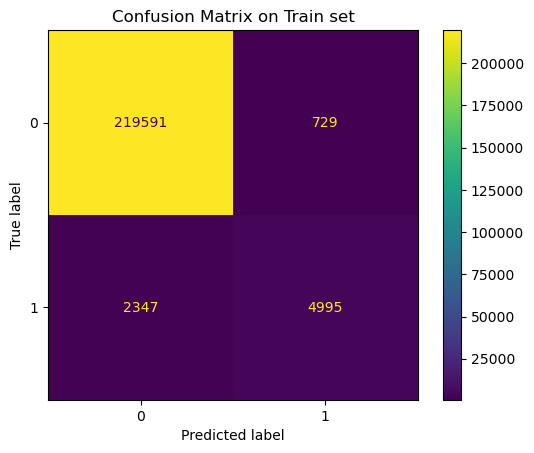

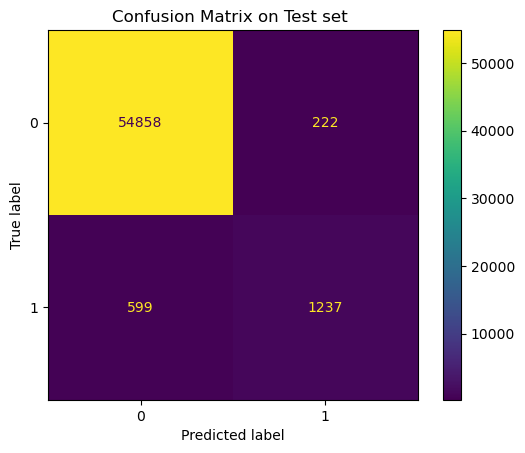

In [111]:
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
print("...Done.")
print()

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
numeric_transformer = Pipeline(steps=[
        ('scaler', SimpleImputer(strategy='mean'))
])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

print("Performing preprocessings on train set...")
print(X_train.head())
X_train = featureencoder.fit_transform(X_train)
print('...Done.')
print(X_train[0:5]) # MUST use this syntax because X_train is a numpy array and not a pandas DataFrame anymore
print()

# Train model
print("Train model...")
#RF_classifier = RandomForestClassifier() 
RF_classifier = RandomForestClassifier(max_depth= 8, min_samples_leaf=5, min_samples_split=8, n_estimators = 80) 
RF_classifier.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = RF_classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = RF_classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(RF_classifier, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(RF_classifier, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

Avec les valeurs par défaut le résultat est moins bon que les autres algos. De plus il semble overfiter légèrement car sur le train il est à 0.8 et 0.73 sur le val.... Essayons de trouver des paramètres plus adéquats

Après Grid Search c'est interressant, l'overfitting a diminué et nous avonbs un score un peu meilleur

In [55]:
print("Grid search...")
params = {
    'max_depth': [2, 4, 6, 8, 10],
    'min_samples_leaf': [1, 2, 5],
    'min_samples_split': [2, 4, 8],
    'n_estimators': [10, 20, 40, 60, 80, 100]
}
gridsearch = GridSearchCV(RF_classifier, param_grid = params, cv = 10) # cv : the number of folds to be used for CV
gridsearch.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)

Grid search...
...Done.
Best hyperparameters :  {'max_depth': 8, 'min_samples_leaf': 5, 'min_samples_split': 8, 'n_estimators': 80}
Best validation accuracy :  0.9861022072659722


# Ensemble learning : XGBOOST

In [64]:
!pip install xgboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 1.4 MB/s eta 0:00:00a 0:00:010m


Explanatory variables :  Index(['total_pages_visited', 'age', 'new_user', 'country', 'source'], dtype='object')

Dividing into train and test sets...
...Done.

Encoding categorical features and standardizing numerical features...
Performing preprocessings on train set...
        total_pages_visited  age  new_user  country  source
70238                     5   23         0       US  Direct
11738                     4   26         1       US     Ads
51223                     2   39         1  Germany     Ads
251695                    8   39         1       US     Seo
30005                     2   44         1       US     Seo
...Done.
[[ 0.0376251  -0.91614386 -1.47777425  0.          0.          1.
   1.          0.        ]
 [-0.2616379  -0.55333446  0.67669334  0.          0.          1.
   0.          0.        ]
 [-0.86016391  1.01883962  0.67669334  1.          0.          0.
   0.          0.        ]
 [ 0.9354141   1.01883962  0.67669334  0.          0.          1.
   0.         

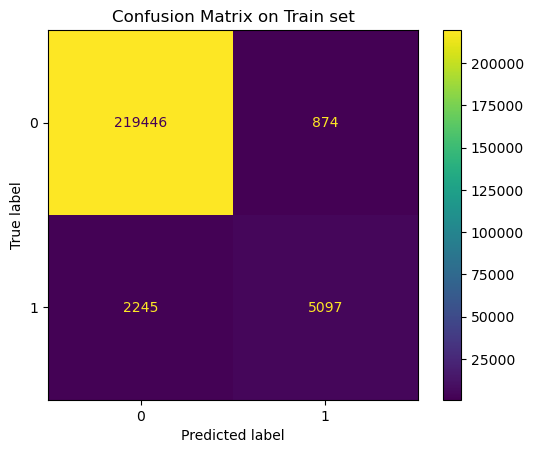

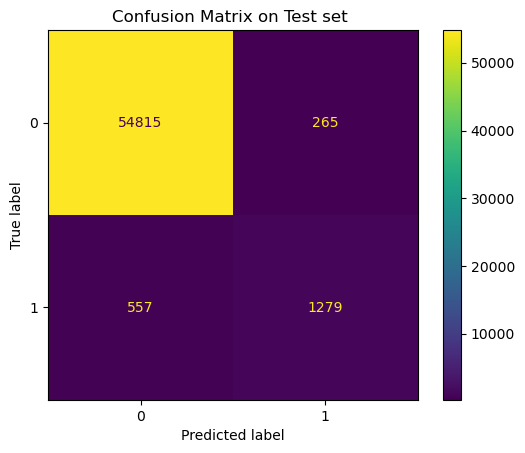

In [68]:
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
print("...Done.")
print()

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
numeric_transformer = Pipeline(steps=[
        ('scaler', StandardScaler())
])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

print("Performing preprocessings on train set...")
print(X_train.head())
X_train = featureencoder.fit_transform(X_train)
print('...Done.')
print(X_train[0:5]) # MUST use this syntax because X_train is a numpy array and not a pandas DataFrame anymore
print()

# Train model
print("Train model...")
#XGB_classifier = XGBClassifier() 
XGB_classifier = XGBClassifier(max_depth=6, min_child_weight=1, n_estimators=8) 
XGB_classifier.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = XGB_classifier.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = XGB_classifier.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(XGB_classifier, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(XGB_classifier, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

0,756 XGBOOST fait bien 

In [67]:
print("Grid search...")
params = {
    'max_depth': [2, 4, 6], # exactly the same role as in scikit-learn
    'min_child_weight': [1, 2, 3], # effect is more or less similar to min_samples_leaf and min_samples_split
    'n_estimators': [2, 4, 6, 8,] # exactly the same role as in scikit-learn
}
gridsearch = GridSearchCV(XGB_classifier, param_grid = params, cv = 10) # cv : the number of folds to be used for CV
gridsearch.fit(X_train, Y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)

Grid search...
...Done.
Best hyperparameters :  {'max_depth': 6, 'min_child_weight': 1, 'n_estimators': 8}
Best validation accuracy :  0.9858386580931222


# Voting

Explanatory variables :  Index(['total_pages_visited', 'age', 'new_user', 'country', 'source'], dtype='object')

Dividing into train and test sets...
...Done.

Encoding categorical features and standardizing numerical features...
Performing preprocessings on train set...
        total_pages_visited  age  new_user  country  source
70238                     5   23         0       US  Direct
11738                     4   26         1       US     Ads
51223                     2   39         1  Germany     Ads
251695                    8   39         1       US     Seo
30005                     2   44         1       US     Seo
...Done.
[[ 0.0376251  -0.91614386 -1.47777425  0.          0.          1.
   1.          0.        ]
 [-0.2616379  -0.55333446  0.67669334  0.          0.          1.
   0.          0.        ]
 [-0.86016391  1.01883962  0.67669334  1.          0.          0.
   0.          0.        ]
 [ 0.9354141   1.01883962  0.67669334  0.          0.          1.
   0.         

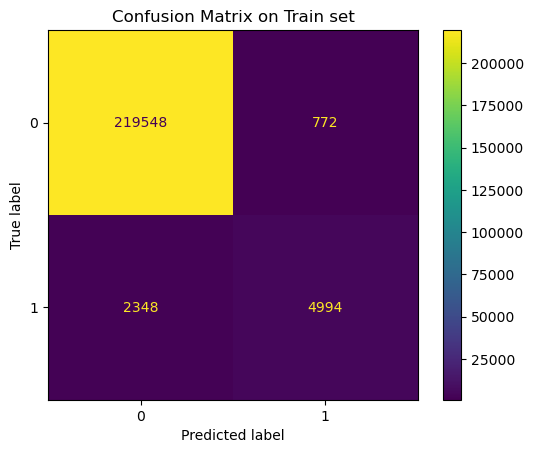

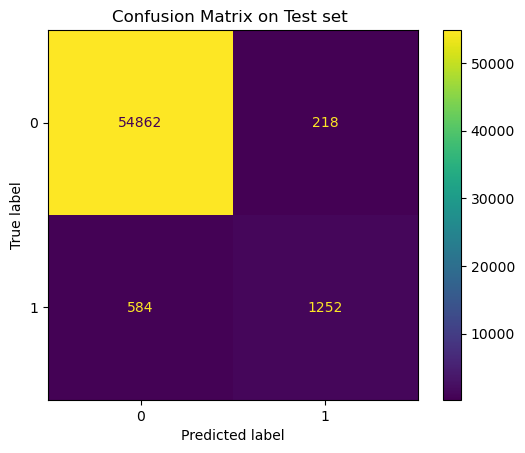

In [87]:
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
X_test_save = X_test
Y_test_save = Y_test
print("...Done.")
print()

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
numeric_transformer = Pipeline(steps=[
        ('scaler', StandardScaler())
])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

print("Performing preprocessings on train set...")
print(X_train.head())
X_train = featureencoder.fit_transform(X_train)
print('...Done.')
print(X_train[0:5]) # MUST use this syntax because X_train is a numpy array and not a pandas DataFrame anymore
print()


# Train model
print("Train model...")
voting = VotingClassifier(estimators=[
    ("logisticRegression", classifier), 
    ("SGD", SGD_classifier), 
    #("Linear SVC", LSVC_classifier), 
    ("SVC", SVC_classifier), 
    ("Random Forest",RF_classifier),
    ("XGBOOST",XGB_classifier)], voting='soft') # soft: use probabilities for voting
voting.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = voting.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()



# Predictions on training set
print("Predictions on training set...")
Y_train_pred = voting.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = voting.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(voting, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(voting, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

On obtient un F1 sur le val à 0.7597 en voting. à voir ce que cela pourrait donné sur le learder board. 

# Analyse du modele

Récupérons les data du X test et les prédiction pour analyser en detail sur quel type dérreur le modèle se rate. 

In [89]:
df_check = pd.DataFrame(X_test_save)
df_check['True'] = Y_test_save
df_check['Predict'] = Y_test_pred
mask = (df_check['True'] != df_check['Predict']) & (df_check['True'] == 1)
df_check[mask]

,total_pages_visited,age,new_user,country,source,True,Predict
49499,11,30,0,UK,Ads,1,0
249438,7,22,0,UK,Seo,1,0
226765,11,33,0,US,Ads,1,0
162983,13,22,1,US,Seo,1,0
38639,10,25,0,Germany,Seo,1,0
...,...,...,...,...,...,...,...
75988,10,21,1,UK,Ads,1,0
104419,8,17,0,US,Ads,1,0
64044,12,24,1,UK,Seo,1,0
46048,8,23,0,US,Seo,1,0


In [ ]:
mask = (df_check['True'] != df_check['Predict']) & (df_check['True'] == 1)
df_check[mask].groupby

In [90]:
#Graphe des probas d'achat en fonction de l'age
num_features = ['total_pages_visited']
for f in num_features:
    fig = px.histogram(df_check[mask], f)
    fig.show()

On constat un problème majeur, les pages visitées à plus de 10 ne sont pas considérer comme des achats ... Il faut donc indiquer au modèle ou corriger les données pour que ce facteurs rentre en compte. 

In [92]:
#Graphe des probas d'achat en fonction de l'age
num_features = ['total_pages_visited']
for f in num_features:
    fig = px.histogram(data, f, color = 'converted', facet_row = 'converted', histnorm = 'probability')
    fig.show()

Explanatory variables :  Index(['total_pages_visited', 'age', 'new_user', 'country', 'source'], dtype='object')

Dividing into train and test sets...
...Done.

Encoding categorical features and standardizing numerical features...
Performing preprocessings on train set...
        total_pages_visited  age  new_user  country  source
70238                     5   23         0       US  Direct
11738                     4   26         1       US     Ads
51223                     2   39         1  Germany     Ads
251695                    8   39         1       US     Seo
30005                     2   44         1       US     Seo
...Done.
[[ 0.0376251  -0.91614386 -1.47777425  0.          0.          1.
   1.          0.        ]
 [-0.2616379  -0.55333446  0.67669334  0.          0.          1.
   0.          0.        ]
 [-0.86016391  1.01883962  0.67669334  1.          0.          0.
   0.          0.        ]
 [ 0.9354141   1.01883962  0.67669334  0.          0.          1.
   0.         

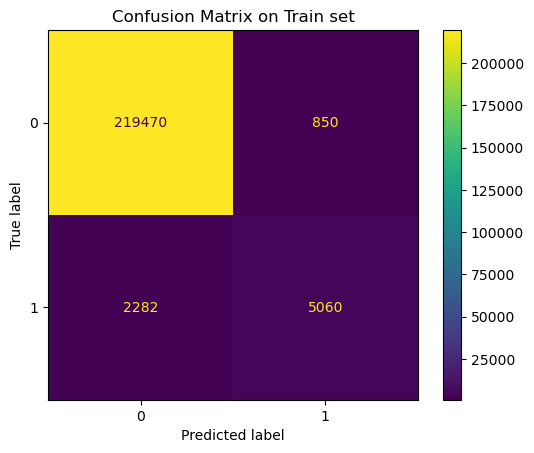

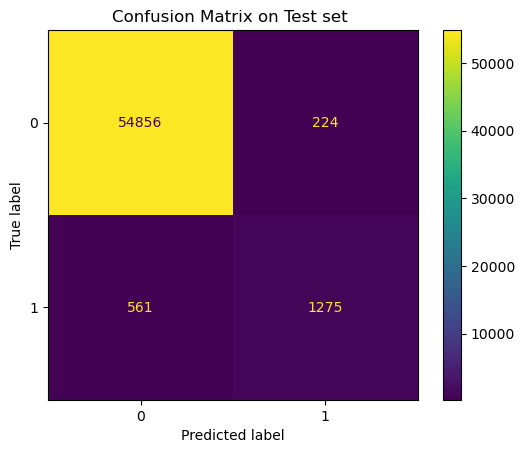

In [115]:
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
X_test_save = X_test
Y_test_save = Y_test
print("...Done.")
print()

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
numeric_transformer = Pipeline(steps=[
        ('scaler', StandardScaler())
])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

print("Performing preprocessings on train set...")
print(X_train.head())
X_train = featureencoder.fit_transform(X_train)
print('...Done.')
print(X_train[0:5]) # MUST use this syntax because X_train is a numpy array and not a pandas DataFrame anymore
print()


# Train model
print("Train model...")
voting = VotingClassifier(estimators=[
    ("logisticRegression", classifier), 
    ("TotalPageCalssi", tot_pg_only_classifier), 
    ("SGD", SGD_classifier), 
    ("Linear SVC", LSVC_classifier), 
    ("SVC", SVC_classifier), 
    ("Random Forest",RF_classifier),
    ("XGBOOST",XGB_classifier)], voting='hard',weights=[0.2,0.4,0.2,0.05,0.05,0.05,0.05]) # soft: use probabilities for voting
voting.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = voting.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()



# Predictions on training set
print("Predictions on training set...")
Y_train_pred = voting.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = voting.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(voting, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(voting, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

In [99]:
df_test = pd.DataFrame(X_train)

In [100]:
df_test

,0,1,2,3,4,5,6,7
0,0.037625,-0.916144,-1.477774,0.0,0.0,1.0,1.0,0.0
1,-0.261638,-0.553334,0.676693,0.0,0.0,1.0,0.0,0.0
2,-0.860164,1.018840,0.676693,1.0,0.0,0.0,0.0,0.0
3,0.935414,1.018840,0.676693,0.0,0.0,1.0,0.0,1.0
4,-0.860164,1.623522,0.676693,0.0,0.0,1.0,0.0,1.0
...,...,...,...,...,...,...,...,...
227657,3.628781,-0.674271,-1.477774,0.0,1.0,0.0,0.0,0.0
227658,-0.560901,1.744458,-1.477774,0.0,0.0,0.0,0.0,1.0
227659,-1.159427,0.051348,-1.477774,0.0,0.0,1.0,0.0,0.0
227660,1.234677,-0.432398,-1.477774,0.0,1.0,0.0,0.0,0.0


In [105]:
df_check = pd.DataFrame(X_test_save)
df_check['True'] = Y_test_save
df_check['Predict'] = Y_test_pred
mask = (df_check['True'] != df_check['Predict']) & (df_check['True'] == 0)
df_check[mask]

,total_pages_visited,age,new_user,country,source,True,Predict
284214,17,30,1,US,Seo,0,1
41204,14,37,0,US,Ads,0,1
17491,13,28,0,US,Ads,0,1
212939,18,39,1,UK,Seo,0,1
169400,14,17,1,US,Seo,0,1
...,...,...,...,...,...,...,...
175970,13,25,0,US,Direct,0,1
20749,16,33,1,US,Seo,0,1
187645,14,18,1,US,Ads,0,1
124854,13,19,0,US,Seo,0,1


In [ ]:
RF_classifier

# Stacking

In [ ]:
# Default: LogisticRegression will be used as final estimator
print('Training stacking classifier...')
stacking = StackingClassifier(estimators = [("logistic", logreg), ("tree", dt), ("svm", svm)], cv = 3)
preds = stacking.fit_transform(X_train, Y_train)
predictions = pd.DataFrame(preds, columns=stacking.named_estimators_.keys())
print('...Done.')
display(predictions)
print("Accuracy on training set : ", stacking.score(X_train, Y_train))
print("Accuracy on test set : ", stacking.score(X_test, Y_test))

Explanatory variables :  Index(['total_pages_visited', 'age', 'new_user', 'country', 'source'], dtype='object')

Dividing into train and test sets...
...Done.

Encoding categorical features and standardizing numerical features...
Performing preprocessings on train set...
        total_pages_visited  age  new_user  country  source
70238                     5   23         0       US  Direct
11738                     4   26         1       US     Ads
51223                     2   39         1  Germany     Ads
251695                    8   39         1       US     Seo
30005                     2   44         1       US     Seo
...Done.
[[ 0.0376251  -0.91614386 -1.47777425  0.          0.          1.
   1.          0.        ]
 [-0.2616379  -0.55333446  0.67669334  0.          0.          1.
   0.          0.        ]
 [-0.86016391  1.01883962  0.67669334  1.          0.          0.
   0.          0.        ]
 [ 0.9354141   1.01883962  0.67669334  0.          0.          1.
   0.         

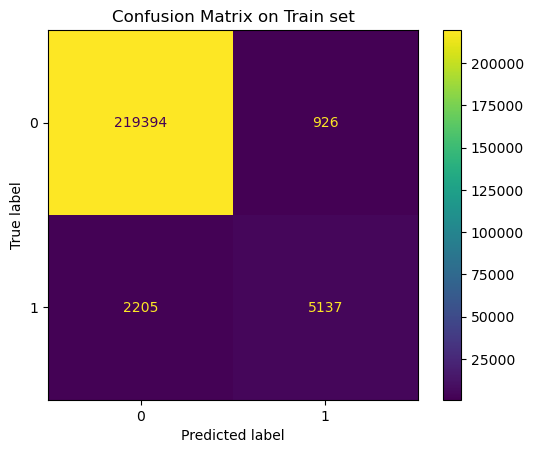

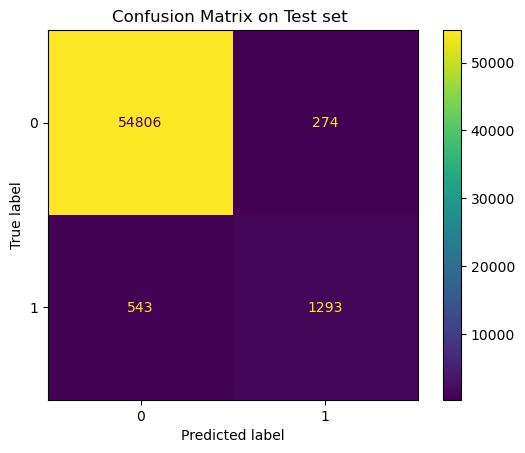

In [119]:
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]
print('Explanatory variables : ', X.columns)
print()

# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
X_test_save = X_test
Y_test_save = Y_test
print("...Done.")
print()

# Put here all the preprocessings
print("Encoding categorical features and standardizing numerical features...")
numeric_transformer = Pipeline(steps=[
        ('scaler', StandardScaler())
])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

print("Performing preprocessings on train set...")
print(X_train.head())
X_train = featureencoder.fit_transform(X_train)
print('...Done.')
print(X_train[0:5]) # MUST use this syntax because X_train is a numpy array and not a pandas DataFrame anymore
print()


# Train model
print("Train model...")
stacking = StackingClassifier(estimators=[
    ("logisticRegression", classifier), 
    ("TotalPageCalssi", tot_pg_only_classifier), 
    ("SGD", SGD_classifier), 
    ("Linear SVC", LSVC_classifier), 
    ("SVC", SVC_classifier), 
    ("Random Forest",RF_classifier),
    ("XGBOOST",XGB_classifier)],final_estimator = RandomForestClassifier(),cv=10) # soft: use probabilities for voting
stacking.fit(X_train, Y_train)
print("...Done.")

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = stacking.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Predictions on training set
print("Predictions on training set...")
Y_train_pred = stacking.predict(X_train)
print("...Done.")
print(Y_train_pred)
print()

# Use X_test, and the same preprocessings as in training pipeline, 
# but call "transform()" instead of "fit_transform" methods (see example below)
print("Encoding categorical features and standardizing numerical features...")
X_test = featureencoder.transform(X_test)
print("...Done")
print(X_test[0:5,:])

# Predictions on test set
print("Predictions on test set...")
Y_test_pred = stacking.predict(X_test)
print("...Done.")
print(Y_test_pred)
print()

# WARNING : Use the same score as the one that will be used by Kaggle !
# Here, the f1-score will be used to assess the performances on the leaderboard
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

# Visualize confusion matrices
_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Train set") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(stacking, X_train, Y_train, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

_ , ax = plt.subplots() # Get subplot from matplotlib
ax.set(title="Confusion Matrix on Test set ") # Set a title that we will add into ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_estimator(stacking, X_test, Y_test, ax=ax) # ConfusionMatrixDisplay from sklearn
plt.show()

# DRY CODE

En effet pour les raisons de l'exercice le code est souvent identiques d'un modèle à l'autre. On comprend rapidement la puissance de SKLEARN qui nous founit des outils fonctionnant quasiement de la même façon sur la même architecture. 
Factorisons le code

In [184]:
k=0
output = pd.DataFrame(columns=['essai', 'estimator_name', 'f1_score', 'precision', 'recall', 'TP', 'TN', 'FP', 'FN'])

In [188]:
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]

# Divide dataset Train set & Test set 
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
X_test_save = X_test
Y_test_save = Y_test

# Put here all the preprocessings
numeric_transformer = Pipeline(steps=[
        ('scaler', StandardScaler())
])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

X_train = featureencoder.fit_transform(X_train)
X_test = featureencoder.transform(X_test)

#La factorisation peut avoir lieu apres les préprocessing 
#Définissons une liste de classifier que nous voulons tester
classifier_models=[
    ('LogistiqueRegression',LogisticRegression()),
    ('SGDClassifier',SGDClassifier(max_iter=1000,loss='log_loss')),
    ('LinearSVC',LinearSVC(max_iter=10000,penalty='l2',C=1)),
    ('SVC',SVC(C = 1, degree=2,kernel='linear',probability=True)),
    ('RandomForestClassifier',RandomForestClassifier(max_depth= 8, min_samples_leaf=5, min_samples_split=8, n_estimators = 80)),
    ('XGBClassifier',XGBClassifier(max_depth=6, min_child_weight=1, n_estimators=8))
]

#Boucle sur les model
k += 1 
for model_test in classifier_models:
    # Train model
    model_test[1].fit(X_train, Y_train)

    # Predictions on test set
    Y_test_pred = model_test[1].predict(X_test)
    
    cm = confusion_matrix(Y_test,Y_test_pred)
    result = {
              'essai' : k,
              'estimator_name' : model_test[0],
              'f1_score' : f1_score(Y_test,Y_test_pred),
              'precision' : precision_score(Y_test,Y_test_pred),
              'recall' : recall_score(Y_test,Y_test_pred),
              'TP' : cm[1][1],
              'TN' : cm[0][0],
              'FP' : cm[0][1],
              'FN' : cm[1][0],
              'feature_names' : features_list,
              'params' : model_test[1].get_params,
              'pipeline' : featureencoder.get_params()
             }
    output = pd.concat([pd.DataFrame([result]),output],ignore_index=True,axis=0)

stacking = StackingClassifier(estimators=classifier_models,final_estimator = RandomForestClassifier(),cv=10)
stacking.fit(X_train, Y_train)
Y_test_pred = stacking.predict(X_test)
cm = confusion_matrix(Y_test,Y_test_pred)
result = {
            'essai' : k,
            'estimator_name' : 'Stacking',
            'f1_score' : f1_score(Y_test,Y_test_pred),
            'precision' : precision_score(Y_test,Y_test_pred),
            'recall' : recall_score(Y_test,Y_test_pred),
            'TP' : cm[1][1],
            'TN' : cm[0][0],
            'FP' : cm[0][1],
            'FN' : cm[1][0],
            'feature_names' : features_list,
            'params' : model_test[1].get_params,
            'pipeline' : featureencoder.get_params()
            }
output = pd.concat([pd.DataFrame([result]),output],ignore_index=True,axis=0)

voting = VotingClassifier(estimators=classifier_models, voting='hard',weights=[0.2,0.6,0.05,0.05,0.05,0.05])
voting.fit(X_train, Y_train)
Y_test_pred = voting.predict(X_test)
cm = confusion_matrix(Y_test,Y_test_pred)
result = {
            'essai' : k,
            'estimator_name' : 'Voting',
            'f1_score' : f1_score(Y_test,Y_test_pred),
            'precision' : precision_score(Y_test,Y_test_pred),
            'recall' : recall_score(Y_test,Y_test_pred),
            'TP' : cm[1][1],
            'TN' : cm[0][0],
            'FP' : cm[0][1],
            'FN' : cm[1][0],
            'feature_names' : features_list,
            'params' : model_test[1].get_params,
            'pipeline' : featureencoder.get_params()
            }
output = pd.concat([pd.DataFrame([result]),output],ignore_index=True,axis=0)
    

In [189]:
output

,essai,estimator_name,f1_score,precision,recall,TP,TN,FP,FN,feature_names,params,pipeline
0,2,Voting,0.760132,0.846823,0.689542,1266,54851,229,570,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
1,2,Stacking,0.750600,0.834667,0.681917,1252,54832,248,584,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
2,2,XGBClassifier,0.756805,0.828368,0.696623,1279,54815,265,557,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
3,2,RandomForestClassifier,0.748403,0.847691,0.669935,1230,54859,221,606,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of Rand...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
4,2,SVC,0.757594,0.856456,0.679194,1247,54871,209,589,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of SVC(...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
5,2,LinearSVC,0.755949,0.859223,0.674837,1239,54877,203,597,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of Line...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
6,2,SGDClassifier,0.760345,0.838477,0.695534,1277,54834,246,559,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of SGDC...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
7,2,LogistiqueRegression,0.764618,0.850567,0.694444,1275,54856,224,561,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of Logi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
8,1,XGBClassifier,0.756805,0.828368,0.696623,1279,54815,265,557,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
9,1,RandomForestClassifier,0.748332,0.844049,0.672113,1234,54852,228,602,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of Rand...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."


In [191]:
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]

# Divide dataset Train set & Test set 
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
X_test_save = X_test
Y_test_save = Y_test

# Put here all the preprocessings
numeric_transformer = Pipeline(steps=[
        ('Poly',PolynomialFeatures(4)),
        ('scaler', StandardScaler())
])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

X_train = featureencoder.fit_transform(X_train)
X_test = featureencoder.transform(X_test)

#La factorisation peut avoir lieu apres les préprocessing 
#Définissons une liste de classifier que nous voulons tester
classifier_models=[
    ('LogistiqueRegression',LogisticRegression()),
    ('SGDClassifier',SGDClassifier(max_iter=1000,loss='log_loss')),
    ('LinearSVC',LinearSVC(max_iter=10000,penalty='l2',C=1)),
    ('SVC',SVC(C = 1, degree=2,kernel='linear',probability=True)),
    ('RandomForestClassifier',RandomForestClassifier(max_depth= 8, min_samples_leaf=5, min_samples_split=8, n_estimators = 80)),
    ('XGBClassifier',XGBClassifier(max_depth=6, min_child_weight=1, n_estimators=8))
]

#Boucle sur les model
k += 1 
for model_test in classifier_models:
    # Train model
    model_test[1].fit(X_train, Y_train)

    # Predictions on test set
    Y_test_pred = model_test[1].predict(X_test)
    
    cm = confusion_matrix(Y_test,Y_test_pred)
    result = {
              'essai' : k,
              'estimator_name' : model_test[0],
              'f1_score' : f1_score(Y_test,Y_test_pred),
              'precision' : precision_score(Y_test,Y_test_pred),
              'recall' : recall_score(Y_test,Y_test_pred),
              'TP' : cm[1][1],
              'TN' : cm[0][0],
              'FP' : cm[0][1],
              'FN' : cm[1][0],
              'feature_names' : features_list,
              'params' : model_test[1].get_params,
              'pipeline' : featureencoder.get_params()
             }
    output = pd.concat([pd.DataFrame([result]),output],ignore_index=True,axis=0)

stacking = StackingClassifier(estimators=classifier_models,final_estimator = RandomForestClassifier(),cv=10)
stacking.fit(X_train, Y_train)
Y_test_pred = stacking.predict(X_test)
cm = confusion_matrix(Y_test,Y_test_pred)
result = {
            'essai' : k,
            'estimator_name' : 'Stacking',
            'f1_score' : f1_score(Y_test,Y_test_pred),
            'precision' : precision_score(Y_test,Y_test_pred),
            'recall' : recall_score(Y_test,Y_test_pred),
            'TP' : cm[1][1],
            'TN' : cm[0][0],
            'FP' : cm[0][1],
            'FN' : cm[1][0],
            'feature_names' : features_list,
            'params' : model_test[1].get_params,
            'pipeline' : featureencoder.get_params()
            }
output = pd.concat([pd.DataFrame([result]),output],ignore_index=True,axis=0)

voting = VotingClassifier(estimators=classifier_models, voting='hard',weights=[0.2,0.6,0.05,0.05,0.05,0.05])
voting.fit(X_train, Y_train)
Y_test_pred = voting.predict(X_test)
cm = confusion_matrix(Y_test,Y_test_pred)
result = {
            'essai' : k,
            'estimator_name' : 'Voting',
            'f1_score' : f1_score(Y_test,Y_test_pred),
            'precision' : precision_score(Y_test,Y_test_pred),
            'recall' : recall_score(Y_test,Y_test_pred),
            'TP' : cm[1][1],
            'TN' : cm[0][0],
            'FP' : cm[0][1],
            'FN' : cm[1][0],
            'feature_names' : features_list,
            'params' : model_test[1].get_params,
            'pipeline' : featureencoder.get_params()
            }
output = pd.concat([pd.DataFrame([result]),output],ignore_index=True,axis=0)
    

/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.

/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.or

In [193]:
output

,essai,estimator_name,f1_score,precision,recall,TP,TN,FP,FN,feature_names,params,pipeline
0,3,Voting,0.760411,0.798204,0.726035,1333,54743,337,503,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
1,3,Stacking,0.745357,0.828229,0.677560,1244,54822,258,592,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
2,3,XGBClassifier,0.757826,0.827742,0.698802,1283,54813,267,553,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
3,3,RandomForestClassifier,0.739808,0.822667,0.672113,1234,54814,266,602,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of Rand...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
4,3,SVC,0.739172,0.880934,0.636710,1169,54922,158,667,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of SVC(...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
5,3,LinearSVC,0.743899,0.859386,0.655773,1204,54883,197,632,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of Line...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
6,3,SGDClassifier,0.758794,0.778351,0.740196,1359,54693,387,477,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of SGDC...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
7,3,LogistiqueRegression,0.762961,0.848101,0.693355,1273,54852,228,563,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of Logi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
8,2,Voting,0.760132,0.846823,0.689542,1266,54851,229,570,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
9,2,Stacking,0.750600,0.834667,0.681917,1252,54832,248,584,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."


In [210]:

#Essai sur des data apres un drop duplicates
#Définition de la feature à analyser
numeric_indices = ['total_pages_visited','age','new_user']
categorical_indices = ['country','source']
features_list = numeric_indices + categorical_indices

#Définition de la target
target_variable = 'converted'

#Création des X,Y avec les data qui nous intéressent
X = data_clean.loc[:, features_list]
Y = data_clean.loc[:, target_variable]

# Divide dataset Train set & Test set 
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0,stratify=Y)
X_test_save = X_test
Y_test_save = Y_test

# Put here all the preprocessings
numeric_transformer = Pipeline(steps=[
        ('scaler', StandardScaler())
])
categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first')) # first column will be dropped to avoid creating correlations between features
    ])
featureencoder = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_indices),
        ('cat', categorical_transformer, categorical_indices)
    ])

X_train = featureencoder.fit_transform(X_train)
X_test = featureencoder.transform(X_test)

#La factorisation peut avoir lieu apres les préprocessing 
#Définissons une liste de classifier que nous voulons tester
classifier_models=[
    ('LogistiqueRegression',LogisticRegression()),
    ('SGDClassifier',SGDClassifier(max_iter=1000,loss='log_loss')),
    ('LinearSVC',LinearSVC(max_iter=10000,penalty='l2',C=1)),
    ('SVC',SVC(C = 1, degree=2,kernel='linear',probability=True)),
    ('RandomForestClassifier',RandomForestClassifier(max_depth= 8, min_samples_leaf=5, min_samples_split=8, n_estimators = 80)),
    ('XGBClassifier',XGBClassifier(max_depth=6, min_child_weight=1, n_estimators=8))
]

#Boucle sur les model
k += 1 
for model_test in classifier_models:
    # Train model
    model_test[1].fit(X_train, Y_train)

    # Predictions on test set
    Y_test_pred = model_test[1].predict(X_test)
    
    cm = confusion_matrix(Y_test,Y_test_pred)
    result = {
              'essai' : k,
              'estimator_name' : model_test[0],
              'f1_score' : f1_score(Y_test,Y_test_pred),
              'precision' : precision_score(Y_test,Y_test_pred),
              'recall' : recall_score(Y_test,Y_test_pred),
              'TP' : cm[1][1],
              'TN' : cm[0][0],
              'FP' : cm[0][1],
              'FN' : cm[1][0],
              'feature_names' : features_list,
              'params' : model_test[1].get_params,
              'pipeline' : featureencoder.get_params()
             }
    output = pd.concat([pd.DataFrame([result]),output],ignore_index=True,axis=0)

stacking = StackingClassifier(estimators=classifier_models,final_estimator = RandomForestClassifier(),cv=10)
stacking.fit(X_train, Y_train)
Y_test_pred = stacking.predict(X_test)
cm = confusion_matrix(Y_test,Y_test_pred)
result = {
            'essai' : k,
            'estimator_name' : 'Stacking',
            'f1_score' : f1_score(Y_test,Y_test_pred),
            'precision' : precision_score(Y_test,Y_test_pred),
            'recall' : recall_score(Y_test,Y_test_pred),
            'TP' : cm[1][1],
            'TN' : cm[0][0],
            'FP' : cm[0][1],
            'FN' : cm[1][0],
            'feature_names' : features_list,
            'params' : model_test[1].get_params,
            'pipeline' : featureencoder.get_params()
            }
output = pd.concat([pd.DataFrame([result]),output],ignore_index=True,axis=0)

voting = VotingClassifier(estimators=classifier_models, voting='hard',weights=[0.2,0.6,0.05,0.05,0.05,0.05])
voting.fit(X_train, Y_train)
Y_test_pred = voting.predict(X_test)
cm = confusion_matrix(Y_test,Y_test_pred)
result = {
            'essai' : k,
            'estimator_name' : 'Voting',
            'f1_score' : f1_score(Y_test,Y_test_pred),
            'precision' : precision_score(Y_test,Y_test_pred),
            'recall' : recall_score(Y_test,Y_test_pred),
            'TP' : cm[1][1],
            'TN' : cm[0][0],
            'FP' : cm[0][1],
            'FN' : cm[1][0],
            'feature_names' : features_list,
            'params' : model_test[1].get_params,
            'pipeline' : featureencoder.get_params()
            }
output = pd.concat([pd.DataFrame([result]),output],ignore_index=True,axis=0)
    

In [209]:
#Création des X,Y avec les data qui nous intéressent
X = data.loc[:, features_list]
Y = data.loc[:, target_variable]

#Boucle sur les model
k += 1 
for model_test in classifier_models:
    
    # Predictions on test set
    Y_test_pred = model_test[1].predict(X)
    
    cm = confusion_matrix(Y,Y_test_pred)
    result ={
              'essai' : k,
              'estimator_name' : model_test[0],
              'f1_score' : f1_score(Y,Y_test_pred),
              'precision' : precision_score(Y,Y_test_pred),
              'recall' : recall_score(Y,Y_test_pred),
              'TP' : cm[1][1],
              'TN' : cm[0][0],
              'FP' : cm[0][1],
              'FN' : cm[1][0],
              'feature_names' : features_list,
              'params' : model_test[1].get_params,
              'pipeline' : featureencoder.get_params()
            }
    output = pd.concat([pd.DataFrame([result]),output],ignore_index=True,axis=0)

stacking = StackingClassifier(estimators=classifier_models,final_estimator = RandomForestClassifier(),cv=10)
stacking.fit(X, Y)
Y_test_pred = stacking.predict(X_test)
cm = confusion_matrix(Y,Y_test_pred)
result = {
            'essai' : k,
            'estimator_name' : 'Stacking',
            'f1_score' : f1_score(Y,Y_test_pred),
            'precision' : precision_score(Y,Y_test_pred),
            'recall' : recall_score(Y,Y_test_pred),
            'TP' : cm[1][1],
            'TN' : cm[0][0],
            'FP' : cm[0][1],
            'FN' : cm[1][0],
            'feature_names' : features_list,
            'params' : model_test[1].get_params,
            'pipeline' : featureencoder.get_params()
            }
output = pd.concat([pd.DataFrame([result]),output],ignore_index=True,axis=0)

voting = VotingClassifier(estimators=classifier_models, voting='hard',weights=[0.2,0.6,0.05,0.05,0.05,0.05])
voting.fit(X, Y)
Y_test_pred = voting.predict(X_test)
cm = confusion_matrix(Y,Y_test_pred)
result = {
            'essai' : k,
            'estimator_name' : 'Voting',
            'f1_score' : f1_score(Y,Y_test_pred),
            'precision' : precision_score(Y,Y_test_pred),
            'recall' : recall_score(Y,Y_test_pred),
            'TP' : cm[1][1],
            'TN' : cm[0][0],
            'FP' : cm[0][1],
            'FN' : cm[1][0],
            'feature_names' : features_list,
            'params' : model_test[1].get_params,
            'pipeline' : featureencoder.get_params()
            }
output = pd.concat([pd.DataFrame([result]),output],ignore_index=True,axis=0)

/Users/mathieu/miniconda3/envs/dataenv/lib/python3.10/site-packages/sklearn/base.py:432: UserWarning:

X has feature names, but LogisticRegression was fitted without feature names



ValueError: could not convert string to float: 'China'

In [199]:
output

,essai,estimator_name,f1_score,precision,recall,TP,TN,FP,FN,feature_names,params,pipeline
0,4,Voting,0.680262,0.832442,0.575123,467,2256,94,345,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
1,4,Stacking,0.666667,0.764331,0.591133,480,2202,148,332,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
2,4,XGBClassifier,0.656739,0.830508,0.543103,441,2260,90,371,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
3,4,RandomForestClassifier,0.635587,0.861053,0.503695,409,2284,66,403,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of Rand...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
4,4,SVC,0.706125,0.800312,0.631773,513,2222,128,299,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of SVC(...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
5,4,LinearSVC,0.703072,0.788668,0.634236,515,2212,138,297,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of Line...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
6,4,SGDClassifier,0.711052,0.773913,0.657635,534,2194,156,278,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of SGDC...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
7,4,LogistiqueRegression,0.702997,0.786585,0.635468,516,2210,140,296,"[total_pages_visited, age, new_user, country, ...",<bound method BaseEstimator.get_params of Logi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
8,3,Voting,0.760411,0.798204,0.726035,1333,54743,337,503,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
9,3,Stacking,0.745357,0.828229,0.677560,1244,54822,258,592,"[total_pages_visited, age, new_user, country, ...",<bound method XGBModel.get_params of XGBClassi...,"{'n_jobs': None, 'remainder': 'drop', 'sparse_..."
